## Copyright 2022 Google LLC. Double-click for license information.

In [1]:
# Copyright 2022 Google LLC
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#      http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

## Prompt-to-Prompt with Stable Diffusion

In [2]:
from typing import Optional, Union, Tuple, List, Callable, Dict
import torch
from diffusers import StableDiffusionPipeline
import torch.nn.functional as nnf
import numpy as np
import abc
import th_ptp_utils as ptp_utils
import th_seq_aligner as seq_aligner
from src import diffusers_sample

In [3]:
# for adapt CustomDiffusion. 
import argparse
import sys
import os
import numpy as np
import torch
from PIL import Image
import pdb

from src.diffusers_model_pipeline import CustomDiffusionPipeline, CustomDiffusionXLPipeline

In [4]:
import numpy as np
np.set_printoptions(edgeitems=30, linewidth=100000, 
    formatter=dict(float=lambda x: "%.3g" % x))

For loading the Stable Diffusion using Diffusers, follow the instuctions https://huggingface.co/blog/stable_diffusion and update ```MY_TOKEN``` with your token.
Set ```LOW_RESOURCE``` to ```True``` for running on 12GB GPU.

## Prompt-to-Prompt Attnetion Controllers
Our main logic is implemented in the `forward` call in an `AttentionControl` object.
The forward is called in each attention layer of the diffusion model and it can modify the input attnetion weights `attn`.

`is_cross`, `place_in_unet in ("down", "mid", "up")`, `AttentionControl.cur_step` help us track the exact attention layer and timestamp during the diffusion iference.


In [5]:
#thum_code
def show_tensor(tensor):
    tensor_cpu = np.array(tensor.to("cpu"))
    print(tensor_cpu.shape)
    print(tensor_cpu.sum())
    print(tensor_cpu)

In [6]:
#thum_code
# def get_alphamask(word_idx):
    

In [7]:
class LocalBlend:
    # 로컬 블렌딩 연산을 정의하는 클래스
    def __call__(self, x_t, attention_store):
        # 호출시 실행되는 메소드
        k = 1
        maps = attention_store["down_cross"][2:4] + attention_store["up_cross"][:3]  # 어텐션 맵 선택 및 결합
        maps = [item.reshape(self.alpha_layers.shape[0], -1, 1, 16, 16, MAX_NUM_WORDS) for item in maps]  # 형태 변환
        maps = torch.cat(maps, dim=1)  # 맵들을 결합
        maps = (maps * self.alpha_layers).sum(-1).mean(1)  # 알파 레이어를 사용하여 가중치 적용
        mask = nnf.max_pool2d(maps, (k * 2 + 1, k * 2 +1), (1, 1), padding=(k, k))  # 맥스 풀링으로 마스크 생성
        mask = nnf.interpolate(mask, size=(x_t.shape[2:]))  # 인터폴레이션을 통한 크기 조정
        mask = mask / mask.max(2, keepdims=True)[0].max(3, keepdims=True)[0]  # 정규화
        mask = mask.gt(self.threshold)  # 임계값을 기준으로 마스크 이진화
        mask = (mask[:1] + mask[1:]).float()  # 마스크 합성
        x_t = x_t[:1] + mask * (x_t - x_t[:1])  # 마스크를 적용한 결과 반환
        return x_t
       
    def __init__(self, prompts: List[str], words: [List[List[str]]], threshold=.3):
        # 초기화 메소드
        alpha_layers = torch.zeros(len(prompts),  1, 1, 1, 1, MAX_NUM_WORDS)  # 알파 레이어 초기화
        for i, (prompt, words_) in enumerate(zip(prompts, words)):
            if type(words_) is str:
                words_ = [words_]
            for word in words_:
                ind = ptp_utils.get_word_inds(prompt, word, tokenizer)  # 단어 인덱스 추출
                alpha_layers[i, :, :, :, :, ind] = 1  # 알파 레이어 업데이트
        self.alpha_layers = alpha_layers.to(device)
        self.threshold = threshold  # 마스크 임계값 설정

# thum_anno
# EmptyControl과 AttentionStore의 상위 클래스. 따라서 빈 함수들이 많음. 
class AttentionControl(abc.ABC):
    # 어텐션 제어를 위한 추상 기본 클래스
    def step_callback(self, x_t):
        # 각 스텝 후

 # 호출되는 콜백 메소드
        return x_t
    
    def between_steps(self):
        # 스텝 사이에 호출되는 메소드
        return
    
    @property
    def num_uncond_att_layers(self):
        # 조건 없는 어텐션 레이어의 수 반환
        return self.num_att_layers if LOW_RESOURCE else 0
    
    @abc.abstractmethod
    def forward (self, attn, is_cross: bool, place_in_unet: str):
        # 어텐션을 수정하는 메소드, 구현 필요
        raise NotImplementedError

    def __call__(self, attn, is_cross: bool, place_in_unet: str, attn_base_=None):
        # 호출시 실행되는 메소드, 어텐션 수정 로직을 포함
        if self.cur_att_layer >= self.num_uncond_att_layers:
            if LOW_RESOURCE:
                attn, attn_base = self.forward(attn, is_cross, place_in_unet, attn_base_)
            else:
                h = attn.shape[0]
                attn[h // 2:] = self.forward(attn[h // 2:], is_cross, place_in_unet, attn_base_)
        self.cur_att_layer += 1
        if self.cur_att_layer == self.num_att_layers + self.num_uncond_att_layers:
            self.cur_att_layer = 0
            self.cur_step += 1
            self.between_steps()
        return attn
    
    def reset(self):
        # 상태 초기화 메소드
        self.cur_step = 0
        self.cur_att_layer = 0

    def __init__(self):
        # 초기화 메소드
        self.cur_step = 0
        self.num_att_layers = -1
        self.cur_att_layer = 0

# thum_anno 빈껍데기인 AttentionControl을 그대로 output하는 함수. 
class EmptyControl(AttentionControl):
    # 어텐션 수정 없이 통과시키는 클래스
    def forward (self, attn, is_cross: bool, place_in_unet: str):
        # 어텐션을 그대로 반환
        return attn
    
# thum_anno 본격적으로 attention을 저장하는 클래스인 것 같음! 
class AttentionStore(AttentionControl):
    # 어텐션 맵을 저장하는 클래스
    @staticmethod
    def get_empty_store():
        # 빈 어텐션 저장소 생성
        return {"down_cross": [], "mid_cross": [], "up_cross": [],
                "down_self": [],  "mid_self": [],  "up_self": []}

    def forward(self, attn, is_cross: bool, place_in_unet: str, attn_base_):
        # 어텐션 맵 저장 로직
        key = f"{place_in_unet}_{'cross' if is_cross else 'self'}"
        if attn.shape[1] <= 32 ** 2:  # 메모리 오버헤드 방지
            # thum_anno get_empty_store()의 출력값 포맷에 맞춰서 attention map을 저장하는 것 같다. 
            self.step_store[key].append(attn)
        return attn

    def between_steps(self):
        # 스텝 사이에 호출되어 어텐션 맵을 종합
        # 매 스탭에 적절한 위치에서 호출되서 현재 스탭에서 저장된 atten들을 attention_store라는 조금 더 큰 딕셔너리에 담아주는 것 같음!
        if len(self.attention_store) == 0:
            self.attention_store = self.step_store
        else:
            for key in self.attention_store:
                for i in range(len(self.attention_store[key])):
                    self.attention_store[key][i] += self.step_store[key][i]
        self.step_store = self.get_empty_store()

    def get_average_attention(self):
        # 평균 어텐션 맵 계산
        average_attention = {key: [item / self.cur_step for item in self.attention_store[key]] for key in self.attention_store}
        return average_attention


    def reset(self):
        # 상태 초기화
        super(AttentionStore, self).reset()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

    def __init__(self):
        # 초기화 메소드
        super(AttentionStore, self).__init__()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

        
    # 이 함수까지 upper class. 
class AttentionControlEdit(AttentionStore, abc.ABC):
    # 어텐션 맵을 수정하는 클래스, AttentionStore를 상속
    def step_callback(self, x_t):
        # 각 스텝 후 호출되는 콜백 메소드, 로컬 블렌딩 적용
        if self.local_blend is not None:
            x_t = self.local_blend(x_t, self.attention_store)
        return x_t
        
    def replace_self_attention(self, attn_base, att_replace):
        # 자기 자신에 대한 어텐션을 대체하는 메소드
        if att_replace.shape[2] <= 16 ** 2:
            return attn_base.unsqueeze(0).expand(att_replace.shape[0], *attn_base.shape)
        else:
            return att_replace
    
    @abc.abstractmethod
    def replace_cross_attention(self, attn_base, att_replace):
        # 다른 토큰에 대한 어텐션을 대체하는 메소드, 구현 필요
        raise NotImplementedError
    
    def forward(self, attn, is_cross: bool, place_in_unet: str, attn_base_=None):
        # 어텐션 수정 로직
        super(AttentionControlEdit, self).forward(attn, is_cross, place_in_unet, attn_base_)
        if is_cross or (self.num_self_replace[0] <= self.cur_step < self.num_self_replace[1]):
            #thum_code
            print("attn.shape before reshape")
            print(attn.shape)
            h = attn.shape[0] // (self.batch_size) # h: head의 개수! 
            attn = attn.reshape(self.batch_size, h, *attn.shape[1:])
            print("attn.shape after reshape")
            print(attn.shape)
            attn_base, attn_repalce = attn[0], attn[1:] # 왜 첫번째 batch 사이즈는 분리하는 것이지?
            print("attn.base shape") 
            print(attn_base.shape)
            print("attn.replace shape")
            print(attn_repalce.shape)
            if attn_base is not None:
                attn_base = attn_base_
                print("attn_base is replaced")
            '''
            -> 이해했다. 그 이유는 다름이 아닌 이 본 논문의 테스크가 두 개의 프롬프트를 사용해서 바뀐 단어만 바꾸는 editing task이기 때문에 \
            두 개의 prompt가 필요하고 한 prompt는 배경을 생성하는데 쓰이고 다른 하나의 prompt는 바뀐 단어를 명시하는데 쓰이기 때문에 \ 
            prompt도 두 개 따라서 batch 가 두개 하나는 base 하나는 replace가 되는 것이다. 
            '''

            # 아래 두 조건문은 cross attention을 replace할 것인지, self-attention을 replace할 것인지를 판단하는 것. 
            if is_cross:
                alpha_words = self.cross_replace_alpha[self.cur_step] # replace할 것에 대한 mask! 
                
                #thum_code
                print(self.cur_step)
                show_tensor(1-alpha_words)
                # attn_repalce_new = self.replace_cross_attention(attn_base, attn_repalce) * alpha_words + (1 - alpha_words) * attn_repalce
                #thum_code
                attn_repalce_new = self.replace_cross_attention(attn_base, attn_repalce) * (alpha_words) + (1-alpha_words) * attn_repalce
                # attn_replace_new에는 replace_cross_attention함수가 적용된, 수정한 attention이 들어있을 것이다! 
                attn[1:] = attn_repalce_new
            else:
                attn[1:] = self.replace_self_attention(attn_base, attn_repalce)
            attn = attn.reshape(self.batch_size * h, *attn.shape[2:])
        # 결국 수정된 attention 값을 출력한다. 
        # return attn
        #thum_code
        return attn
    
    def __init__(self, prompts, num_steps: int,
                 cross_replace_steps: Union[float, Tuple[float, float], Dict[str, Tuple[float, float]]],
                 self_replace_steps: Union[float, Tuple[float, float]],
                 local_blend: Optional[LocalBlend]):
        # 초기화 메소드
        super(AttentionControlEdit, self).__init__()
        self.batch_size = len(prompts)
        # self.batch_size: 입력 prompt의 개수이다. (prompt_base, Prompt_replace.. )
        self.cross_replace_alpha = ptp_utils.get_time_words_attention_alpha(prompts, num_steps, cross_replace_steps, tokenizer).to(device)
        # self.cross_replace_alpha: replace_token에 대한 alpha mask를 생성한다! 
        # self.cross_replace_alpha = get_alphamask(word_idx)

        if type(self_replace_steps) is float:
            self_replace_steps = 0, self_replace_steps
        self.num_self_replace = int(num_steps * self_replace_steps[0]), int(num_steps * self_replace_steps[1])
        # self.num_self_replace: self_replace할 step의 시작과 끝을 지정한다. 
        self.local_blend = local_blend
        # self.local_blend: local_bland라는 기능을 하용할지에 대한 bool값이다. (주로 사용하지 않는 것 같다.)

class AttentionReplace(AttentionControlEdit):
    # 어텐션 맵을 완전히 대체하는 클래스
    def replace_cross_attention(self, attn_base, att_replace):
        # 다른 토큰에 대한 어텐션 대체 로직
        # print("type attn base",type(attn_base))
        # print("shape(attn base)", attn_base.shape)
        # print("shape(self.mapper)", self.mapper.shape)
        '''
        type attn base <class 'torch.Tensor'>
        shape(attn base) torch.Size([8, 4096, 77])
        shape(self.mapper) torch.Size([1, 77, 77])
        '''
        print(type(attn_base))
        return torch.einsum('hpw,bwn->bhpn', attn_base, self.mapper)
        # attention base를 수정해서 출력함! 
        # 생각해보니 attn_base도 중요한 이유가 결국 다시 생성할 때도 가장 많은 부분을 사용하는 것이 attn_base이다 attn_replace는 특정 부위에만 적용될 것이다. 
      
    def __init__(self, prompts, num_steps: int, attn_base, cross_replace_steps: float, self_replace_steps: float,
                 local_blend: Optional[LocalBlend] = None):
        # 초기화 메소드
        # self.local_blend: local_bland라는 기능을 하용할지에 대한 bool값이다. (주로 사용하지 않는 것 같다.)
        # self.num_self_replace: self_replace할 step의 시작과 끝을 지정한다. 
        # self.cross_replace_alpha: replace_token에 대한 alpha mask를 생성한다! 
        # self.batch_size: 입력 prompt의 개수이다. (prompt_base, Prompt_replace.. )
        super(AttentionReplace, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        self.mapper = seq_aligner.get_replacement_mapper(prompts, tokenizer).to(device)
        #thum_code
        # show_tensor(self.mapper)
        
        

class AttentionRefine(AttentionControlEdit):
    # 어텐션 맵을 세밀하게 조정하는 클래스
    def replace_cross_attention(self, attn_base, att_replace):
        # 다른 토큰에 대한 어텐션 조정 로직
        attn_base_replace = attn_base[:, :, self.mapper].permute(2, 0, 1, 3)
        attn_replace = attn_base_replace * self.alphas + att_replace * (1 - self.alphas)
        return attn_replace

    def __init__(self, prompts, num_steps: int, cross_replace_steps: float, self_replace_steps: float,
                 local_blend: Optional[LocalBlend] = None):
        # 초기화 메소드
        super(AttentionRefine, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        self.mapper, alphas = seq_aligner.get_refinement_mapper(prompts, tokenizer)
        self.mapper, alphas = self.mapper.to(device), alphas.to(device)
        self.alphas = alphas.reshape(alphas.shape[0], 1, 1, alphas.shape[1])


class AttentionReweight(AttentionControlEdit):
    # 어텐션 가중치를 재조정하는 클래스
    def replace_cross_attention(self, attn_base, att_replace):
        # 다른 토큰에 대한 어텐션 가중치 재조정 로직
        if self.prev_controller is not None:
            attn_base = self.prev_controller.replace_cross_attention(attn_base, att_replace)
        attn_replace = attn_base[None, :, :, :] * self.equalizer[:, None, None, :]
        return attn_replace

    def __init__(self, prompts, num_steps: int, cross_replace_steps: float, self_replace_steps: float, equalizer,
                local_blend: Optional[LocalBlend] = None, controller: Optional[AttentionControlEdit] = None):
        # 초기화 메소드
        super(AttentionReweight, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        self.equalizer = equalizer.to(device)
        self.prev_controller = controller


def get_equalizer(text: str, word_select: Union[int, Tuple[int, ...]], values: Union[List[float],
                  Tuple[float, ...]]):
    # 특정 단어의 어텐션 가중치를 조정하기 위한 "이퀄라이저" 생성 함수
    if type(word_select) is int or type(word_select) is str:
        word_select = (word_select,)
    equalizer = torch.ones(len(values), 77)
    values = torch.tensor(values, dtype=torch.float32)
    for word in word_select:
        inds = ptp_utils.get_word_inds(text, word, tokenizer)  # 단어 인덱스 추출
        equalizer[:, inds] = values  # 이퀄라이저 업데이트
    return equalizer


In [8]:
from PIL import Image

def aggregate_attention(attention_store: AttentionStore, res: int, from_where: List[str], is_cross: bool, select: int):
    out = []
    attention_maps = attention_store.get_average_attention()
    num_pixels = res ** 2
    for location in from_where:
        for item in attention_maps[f"{location}_{'cross' if is_cross else 'self'}"]:
            if item.shape[1] == num_pixels:
                cross_maps = item.reshape(len(prompts), -1, res, res, item.shape[-1])[select]
                out.append(cross_maps)
    out = torch.cat(out, dim=0)
    out = out.sum(0) / out.shape[0]
    return out.cpu()


def show_cross_attention(attention_store: AttentionStore, res: int, from_where: List[str], select: int = 0):
    tokens = tokenizer.encode(prompts[select])
    decoder = tokenizer.decode
    attention_maps = aggregate_attention(attention_store, res, from_where, True, select)
    images = []
    for i in range(len(tokens)):
        image = attention_maps[:, :, i]
        image = 255 * image / image.max()
        image = image.unsqueeze(-1).expand(*image.shape, 3)
        image = image.numpy().astype(np.uint8)
        image = np.array(Image.fromarray(image).resize((256, 256)))
        image = ptp_utils.text_under_image(image, decoder(int(tokens[i])))
        images.append(image)
    ptp_utils.view_images(np.stack(images, axis=0))
    

def show_self_attention_comp(attention_store: AttentionStore, res: int, from_where: List[str],
                        max_com=10, select: int = 0):
    attention_maps = aggregate_attention(attention_store, res, from_where, False, select).numpy().reshape((res ** 2, res ** 2))
    u, s, vh = np.linalg.svd(attention_maps - np.mean(attention_maps, axis=1, keepdims=True))
    images = []
    for i in range(max_com):
        image = vh[i].reshape(res, res)
        image = image - image.min()
        image = 255 * image / image.max()
        image = np.repeat(np.expand_dims(image, axis=2), 3, axis=2).astype(np.uint8)
        image = Image.fromarray(image).resize((256, 256))
        image = np.array(image)
        images.append(image)
    ptp_utils.view_images(np.concatenate(images, axis=1))

In [9]:
def run_and_display(prompts, controller, latent=None, run_baseline=False, generator=None):
    if run_baseline:
        print("w.o. prompt-to-prompt")
        images, latent = run_and_display(prompts, EmptyControl(), latent=latent, run_baseline=False, generator=generator)
        # above run_baseline should be false all the time! 
        print("with prompt-to-prompt")
    images, x_t = ptp_utils.text2image_ldm_stable(ldm_stable, prompts, controller, latent=latent, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
    ptp_utils.view_images(images)
    return images, x_t

In [10]:
def th_run_and_display(prompts, controller, attn_base=None, latent=None, run_baseline=False, generator=None):
    if run_baseline:
        print("w.o. prompt-to-prompt")
        images, latent = run_and_display(prompts, EmptyControl(), latent=latent, run_baseline=False, generator=generator)
        # above run_baseline should be false all the time! 
        print("with prompt-to-prompt")
    images, x_t, attn_base = ptp_utils.th_text2image_ldm_stable(ldm_stable, prompts, controller, attn_base, latent=latent, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
    ptp_utils.view_images(images)
    return images, x_t, attn_base

## Cross-Attention Visualization
First let's generate an image and visualize the cross-attention maps for each word in the prompt.
Notice, we normalize each map to 0-1.

## Replacement edit

In [11]:
MY_TOKEN = '<replace with your token>'
LOW_RESOURCE = False 
NUM_DIFFUSION_STEPS = 200
GUIDANCE_SCALE = 6
MAX_NUM_WORDS = 77
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
# ldm_stable = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", use_auth_token=MY_TOKEN).to(device)
#thum_code
model_id = "CompVis/stable-diffusion-v1-4"
delta_ckpt = "./logs/jjanggu_and_scene17_b6_LR5e-6/delta-500.bin"
compress = False

ldm_stable = CustomDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float).to("cuda")
ldm_stable.load_model(delta_ckpt, compress) # load_model is for loading modified kv_attention model.!! 
ldm_stable.safety_checker = lambda images, **kwargs: (images, [False] * len(images))

tokenizer = ldm_stable.tokenizer

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

th_is_running
register_attention_control is done!!!
latent.shape
latents.shape
torch.Size([1, 4, 64, 64])
torch.Size([1, 4, 64, 64])
before diffusion_step


/home/work/taehyeon/CustomDiffusion_SceneRegeneration_KT_internship/th_ptp_utils.py:88: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (1, model.unet.in_channels, height // 8, width // 8),
/home/work/taehyeon/CustomDiffusion_SceneRegeneration_KT_internship/th_ptp_utils.py:91: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


  0%|          | 0/201 [00:00<?, ?it/s]

in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 4096, 4096])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 4096, 77])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 4096, 4096])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 4096, 77])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 1024, 1024])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 1024, 77])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 1024, 1024])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 1024, 77])
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([16, 256, 256])
in register attention control type(attention_probs)
<class 'torch.Tensor'>

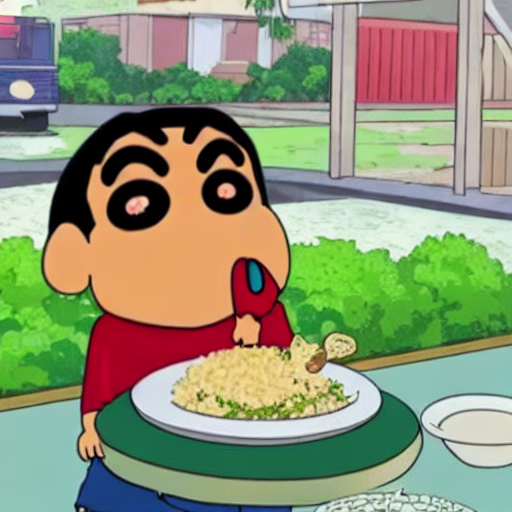

in maincode print type(attn_base)
<class 'NoneType'>


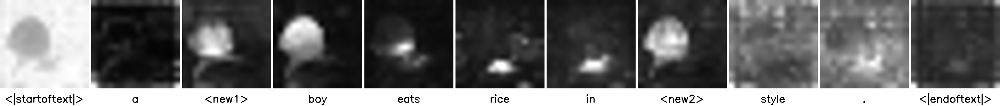

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

th_is_running
register_attention_control is done!!!
latent.shape
latents.shape
torch.Size([1, 4, 64, 64])
torch.Size([2, 4, 64, 64])
before diffusion_step


  0%|          | 0/201 [00:00<?, ?it/s]

attn.shape before reshape
torch.Size([16, 4096, 4096])
attn.shape after reshape
torch.Size([2, 8, 4096, 4096])
attn.base shape
torch.Size([8, 4096, 4096])
attn.replace shape
torch.Size([1, 8, 4096, 4096])
attn_base is replaced
in register attention control type(attention_probs)
<class 'torch.Tensor'>
torch.Size([32, 4096, 4096])
attn.shape before reshape
torch.Size([16, 4096, 77])
attn.shape after reshape
torch.Size([2, 8, 4096, 77])
attn.base shape
torch.Size([8, 4096, 77])
attn.replace shape
torch.Size([1, 8, 4096, 77])
attn_base is replaced
0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]]]
<class 'NoneType'>


TypeError: expected Tensor as element 0 in argument 1, but got NoneType

In [12]:
#first
MY_TOKEN = '<replace with your token>'
LOW_RESOURCE = False 
NUM_DIFFUSION_STEPS = 200
GUIDANCE_SCALE = 6
MAX_NUM_WORDS = 77
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
# ldm_stable = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", use_auth_token=MY_TOKEN).to(device)
#thum_code
model_id = "CompVis/stable-diffusion-v1-4"
delta_ckpt = "./logs/jjanggu_and_scene17_b6_LR5e-6/delta-500.bin"
compress = False

ldm_stable = CustomDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float).to("cuda")
ldm_stable.load_model(delta_ckpt, compress) # load_model is for loading modified kv_attention model.!! 
ldm_stable.safety_checker = lambda images, **kwargs: (images, [False] * len(images))
tokenizer = ldm_stable.tokenizer

# first trial, get base attention latent
g_cpu = torch.Generator().manual_seed(42)
prompts = ["A <new1> boy eats rice in <new2> style."]
controller = AttentionStore()
# Attnstore 인스턴스 자체를 저장. 
# in this phase attention_store() and step_store() is empty! 
image, x_t, attn_base = th_run_and_display(prompts, controller, attn_base=None, latent=None, run_baseline=False, generator=g_cpu)
#       ptp_utils.text2image_ldm_stable()

print("in maincode print type(attn_base)")
print(type(attn_base))

#       
show_cross_attention(controller, res=16, from_where=("up", "down"))

# 모델 다시 등록
delta_ckpt = "./logs/jjanggu_and_scene17_b6_LR5e-6/delta-2000.bin"
compress = False
ldm_stable = CustomDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float).to("cuda")
ldm_stable.load_model(delta_ckpt, compress) # load_model is for loading modified kv_attention model.!! 
ldm_stable.safety_checker = lambda images, **kwargs: (images, [False] * len(images))
tokenizer = ldm_stable.tokenizer

prompts = ["A <new1> boy eats rice in <new2> style.",
           "A <new1> boy eats rice in <new2> style."]

controller = AttentionReplace(prompts, NUM_DIFFUSION_STEPS, attn_base,
        cross_replace_steps={"default_": 1., "<new1>": .4, "boy": .4}, self_replace_steps=0.4)
        # cross_replace_steps 에서 alpha word가 바뀌는 
_ = th_run_and_display(prompts, controller, attn_base, latent=x_t, run_baseline=False)
# thum_code
# _ = run_and_display(prompts, controller, run_baseline=False)

## call 과 forward가 nn.Module에서는 굉장히 비슷하게 쓰이는데 이럴 수 있는 이유는 nn.Module를 설계할 때 forward()를 설계할 때 __call__()처럼 사용할 수 있게 코드를 구성했기 때문. 
## 따라서 controller는 nn.Module를 상솓받지 않았지만, __call__()에서 forward()를 호출하게 함으로써 모듈처럶 사용할 수 있게 했음. 

# code flow
'''

run_and_display(prompts,)
AttentionReplace.__init__(*args)
run_and_display(prompts, controller, latent=x_t, run_baseline=False)
'''


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

latent.shape
latents.shape
torch.Size([1, 4, 64, 64])
torch.Size([1, 4, 64, 64])


/home/work/taehyeon/CustomDiffusion_SceneRegeneration_KT_internship/th_ptp_utils.py:85: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (1, model.unet.in_channels, height // 8, width // 8),
/home/work/taehyeon/CustomDiffusion_SceneRegeneration_KT_internship/th_ptp_utils.py:88: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


  0%|          | 0/201 [00:00<?, ?it/s]

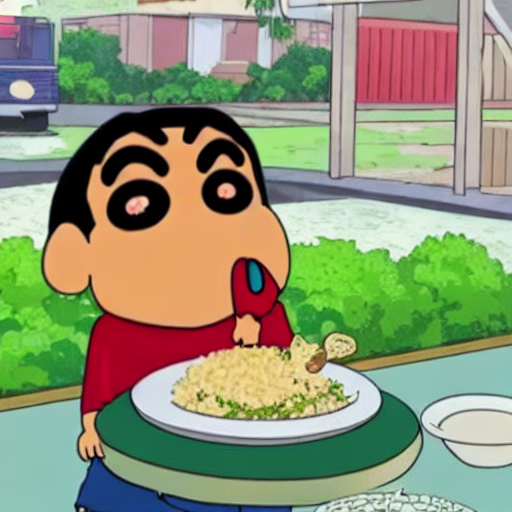

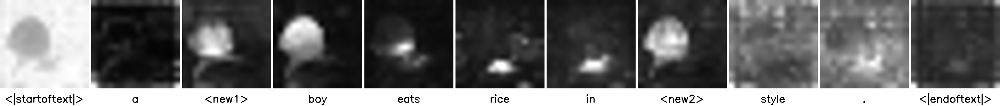

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

latent.shape
latents.shape
torch.Size([1, 4, 64, 64])
torch.Size([2, 4, 64, 64])


  0%|          | 0/201 [00:00<?, ?it/s]

0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]]]
0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]]]
0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]]]
0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]]]
0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]]]
0
(1, 1, 1, 77)
0.0
[[[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

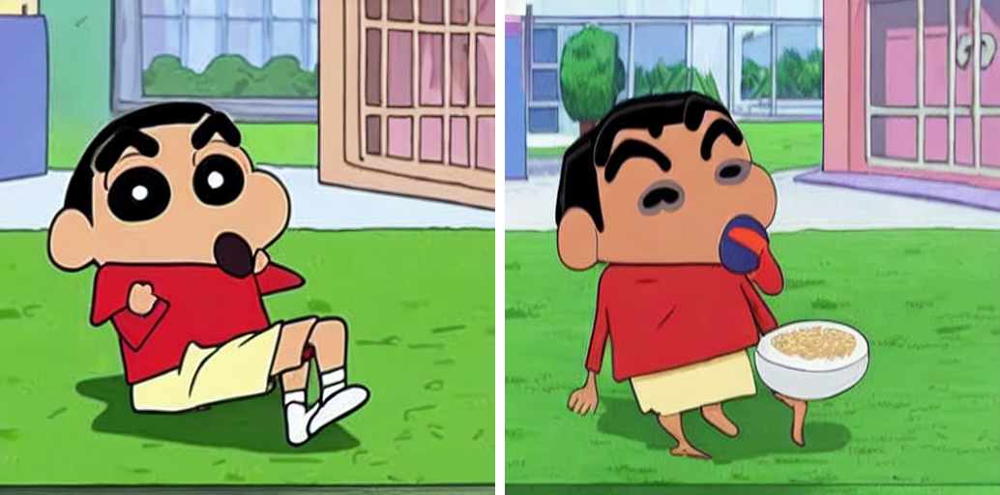

'\n\nrun_and_display(prompts,)\nAttentionReplace.__init__(*args)\nrun_and_display(prompts, controller, latent=x_t, run_baseline=False)\n'

In [ ]:
#second
MY_TOKEN = '<replace with your token>'
LOW_RESOURCE = False 
NUM_DIFFUSION_STEPS = 200
GUIDANCE_SCALE = 6
MAX_NUM_WORDS = 77
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
# ldm_stable = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", use_auth_token=MY_TOKEN).to(device)
#thum_code
model_id = "CompVis/stable-diffusion-v1-4"
delta_ckpt = "./logs/jjanggu_and_scene17_b6_LR5e-6/delta-500.bin"
compress = False

ldm_stable = CustomDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float).to("cuda")
ldm_stable.load_model(delta_ckpt, compress) # load_model is for loading modified kv_attention model.!! 
ldm_stable.safety_checker = lambda images, **kwargs: (images, [False] * len(images))

tokenizer = ldm_stable.tokenizer

# first trial, get base attention latent
g_cpu = torch.Generator().manual_seed(42)
prompts = ["A <new1> boy eats rice in <new2> style."]
controller = AttentionStore()
# Attnstore 인스턴스 자체를 저장. 
# in this phase attention_store() and step_store() is empty! 
image, x_t = run_and_display(prompts, controller, latent=None, run_baseline=False, generator=g_cpu)
#       ptp_utils.text2image_ldm_stable()
#       
show_cross_attention(controller, res=16, from_where=("up", "down"))

# 모델 다시 등록
delta_ckpt = "./logs/jjanggu_and_scene17_b6_LR5e-6/delta-2000.bin"
compress = False
ldm_stable = CustomDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float).to("cuda")
ldm_stable.load_model(delta_ckpt, compress) # load_model is for loading modified kv_attention model.!! 
ldm_stable.safety_checker = lambda images, **kwargs: (images, [False] * len(images))
tokenizer = ldm_stable.tokenizer

prompts = ["A <new1> boy eats rice in <new2> style.",
           "A <new1> girl eats rice in <new2> style."]

controller = AttentionReplace(prompts, NUM_DIFFUSION_STEPS, 
        cross_replace_steps={"default_": 1. , "girl": .4},self_replace_steps=0.4)
        # cross_replace_steps 에서 alpha word가 바뀌는 
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)
# thum_code
# _ = run_and_display(prompts, controller, run_baseline=False)

## call 과 forward가 nn.Module에서는 굉장히 비슷하게 쓰이는데 이럴 수 있는 이유는 nn.Module를 설계할 때 forward()를 설계할 때 __call__()처럼 사용할 수 있게 코드를 구성했기 때문. 
## 따라서 controller는 nn.Module를 상솓받지 않았지만, __call__()에서 forward()를 호출하게 함으로써 모듈처럶 사용할 수 있게 했음. 

# code flow
'''

run_and_display(prompts,)
AttentionReplace.__init__(*args)
run_and_display(prompts, controller, latent=x_t, run_baseline=False)
'''


In [ ]:
#initialize
prompts = ["A painting of a squirrel eating a burger",
           "A painting of a lion eating a burger"]

lb = LocalBlend(prompts, ("squirrel", "lion"))
# type(controller) = attn
# 모델을 불러와서 학습하는 코드는 run_and_display에 내재되어있음. stable diffusion용으로 만들어진 코드라서 모델을 입력값으로 받지 않는 것 같음! 
# cross_replace_steps : 처음부터 어디까지 guidance attn map을 사용할지 비율을 입력함. 
#       ㄴ 실제 사용될 때는 [ 0,  NUM_DIFFUSION_STEPS * cross_replace_steps ]

# controller는 __init__으로 생성된다 ! 
# controller는 AttentionReplacement의 객체라고 할 수 있다. 
controller = AttentionReplace(prompts, NUM_DIFFUSION_STEPS,
                              cross_replace_steps={"default_": 1., "lion": .4},
                              self_replace_steps=0.4, local_blend=lb)
# 생성된 controller는
        # self.local_blend: local_bland라는 기능을 하용할지에 대한 bool값이다. (주로 사용하지 않는 것 같다.)
        # self.num_self_replace: self_replace할 step의 시작과 끝을 지정한다. 
        # self.cross_replace_alpha: replace_token에 대한 alpha mask를 생성한다! 
        # self.batch_size: 입력 prompt의 개수이다. (prompt_base, Prompt_replace.. )
        # self.mapper: 
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

TypeError: can't convert cuda:0 device type tensor to numpy. Use Tensor.cpu() to copy the tensor to host memory first.

In [ ]:
prompts = ["A painting of a squirrel eating a burger",
           "A painting of a lion eating a burger"]

controller = AttentionReplace(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8, self_replace_steps=0.4)

_ = run_and_display(prompts, controller, latent=x_t, run_baseline=True)


NameError: name 'AttentionReplace' is not defined

### Modify Cross-Attention injection #steps for specific words
Next, we can reduce the restriction on our lion by reducing the number of cross-attention injection with respect to the word "lion".

### Local Edit
Lastly, if we want to preseve the original burger, we can apply a local edit with respect to the squirrel and the lion

['a', 'painting', 'of', 'a', 'squirrel', 'eating', 'a', 'burger']
out [8]
inds_source [array([8])]
['a', 'painting', 'of', 'a', 'squirrel', 'eating', 'a', 'lasag', 'ne']
out [8, 9]
inds_target [array([8, 9])]
i 0
j 0
cur_inds 0
mapper [[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0

  0%|          | 0/51 [00:00<?, ?it/s]

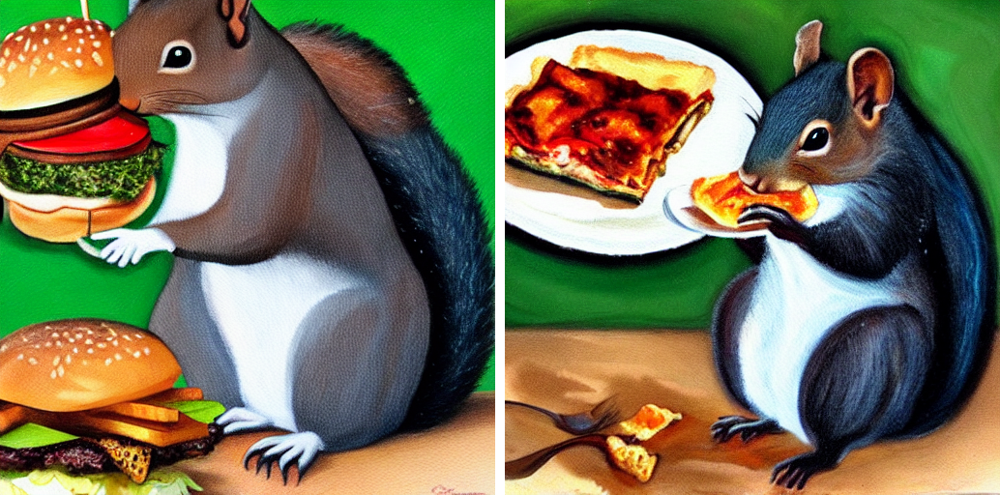

with prompt-to-prompt


  0%|          | 0/51 [00:00<?, ?it/s]

type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 4096, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 4096, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 1024, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 1024, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 256, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 256, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 64, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn base <class 'torch.Tensor'>
shape(attn base) torch.Size([8, 256, 77])
shape(self.mapper) torch.Size([1, 77, 77])
type attn bas

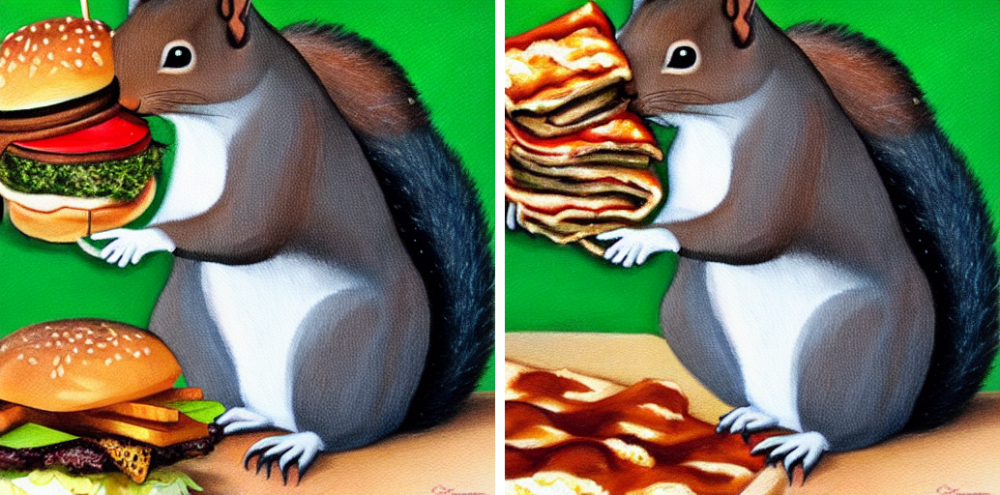

In [ ]:
prompts = ["A painting of a squirrel eating a burger",
           "A painting of a squirrel eating a lasagne"]
lb = LocalBlend(prompts, ("burger", "lasagne"))
controller = AttentionReplace(prompts, NUM_DIFFUSION_STEPS,
                              cross_replace_steps={"default_": 1., "lasagne": .2},
                              self_replace_steps=0.4,
                              local_blend=lb)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=True)

## Refinement edit

  0%|          | 0/51 [00:00<?, ?it/s]

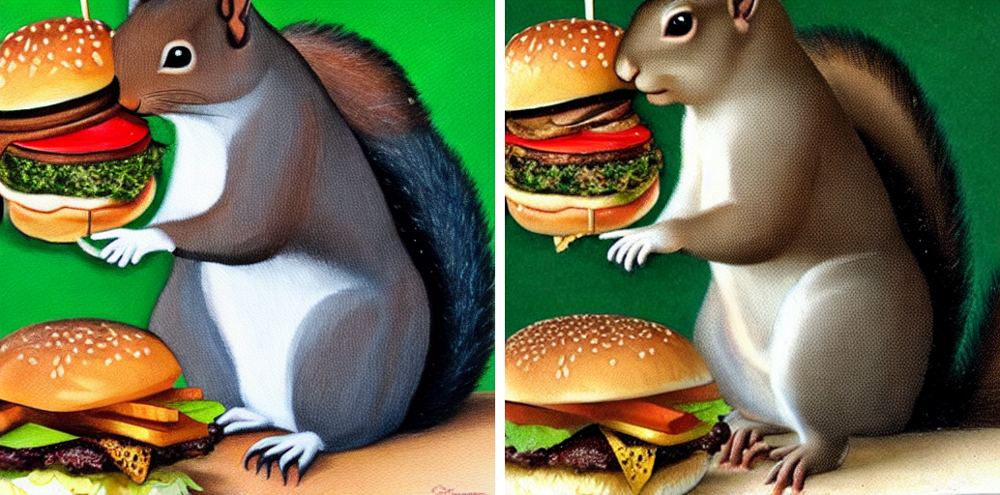

In [ ]:
prompts = ["A painting of a squirrel eating a burger",
           "A neoclassical painting of a squirrel eating a burger"]

controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS,
                             cross_replace_steps=.5, 
                             self_replace_steps=.2)
_ = run_and_display(prompts, controller, latent=x_t)

  0%|          | 0/51 [00:00<?, ?it/s]

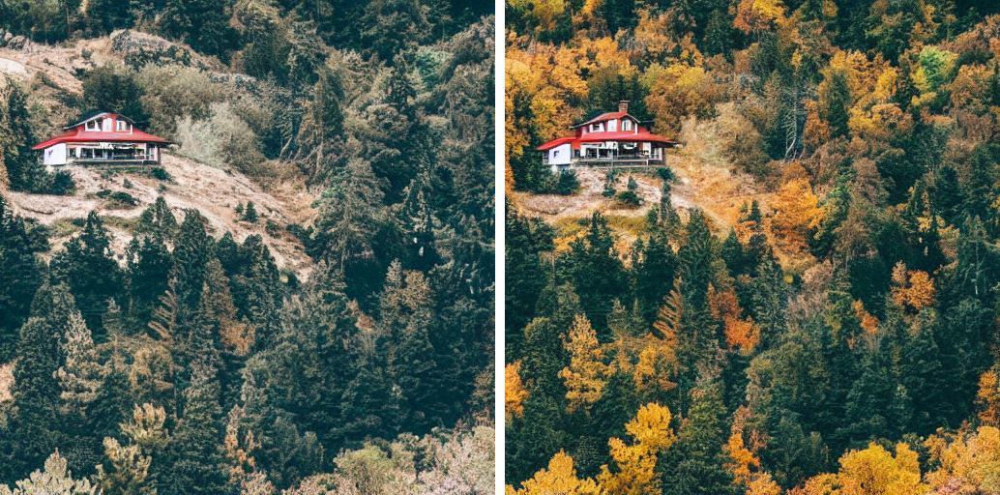

In [ ]:
prompts = ["a photo of a house on a mountain",
           "a photo of a house on a mountain at fall"]


controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                             self_replace_steps=.4)
_ = run_and_display(prompts, controller, latent=x_t)

  0%|          | 0/51 [00:00<?, ?it/s]

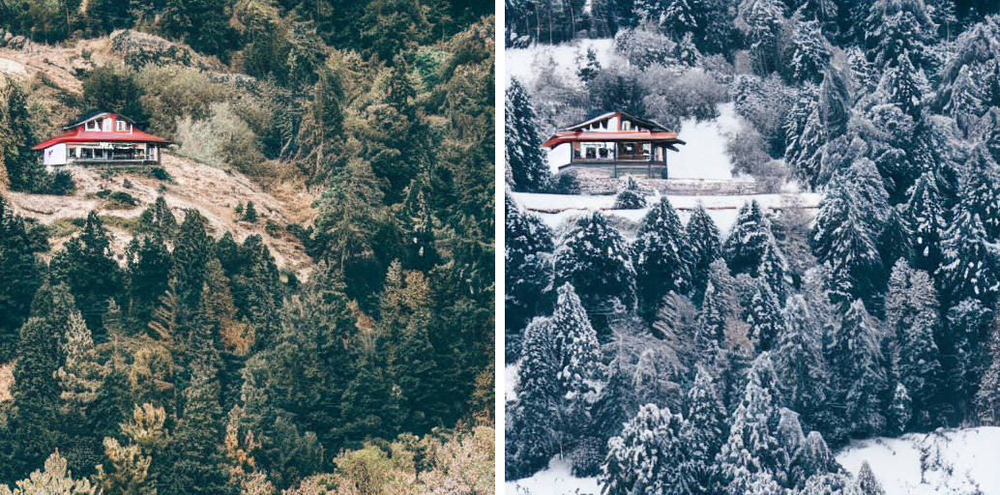

In [ ]:
prompts = ["a photo of a house on a mountain",
           "a photo of a house on a mountain at winter"]


controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                             self_replace_steps=.4)
_ = run_and_display(prompts, controller, latent=x_t)

  0%|          | 0/51 [00:00<?, ?it/s]

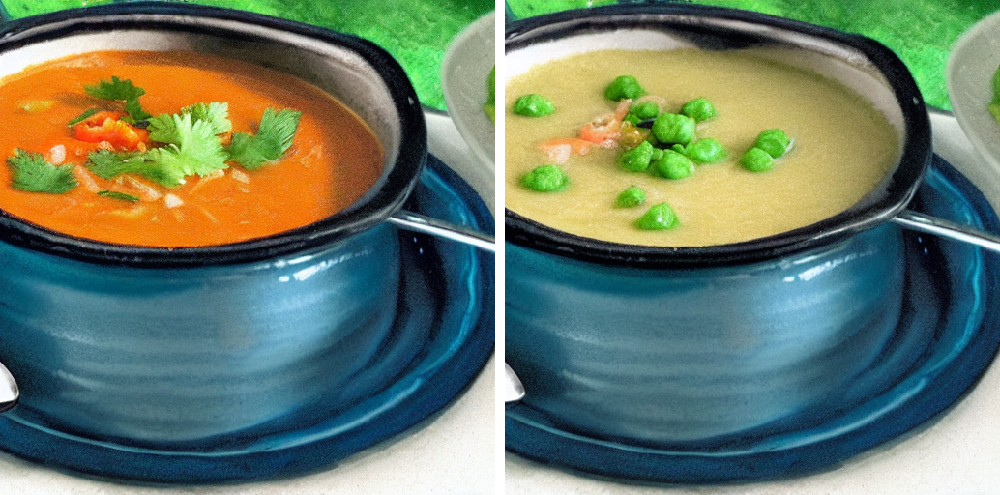

In [ ]:
prompts = ["soup",
           "pea soup"] 

lb = LocalBlend(prompts, ("soup", "soup"))

controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                             self_replace_steps=.4,
                             local_blend=lb)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

## Attention Re-Weighting

  0%|          | 0/51 [00:00<?, ?it/s]

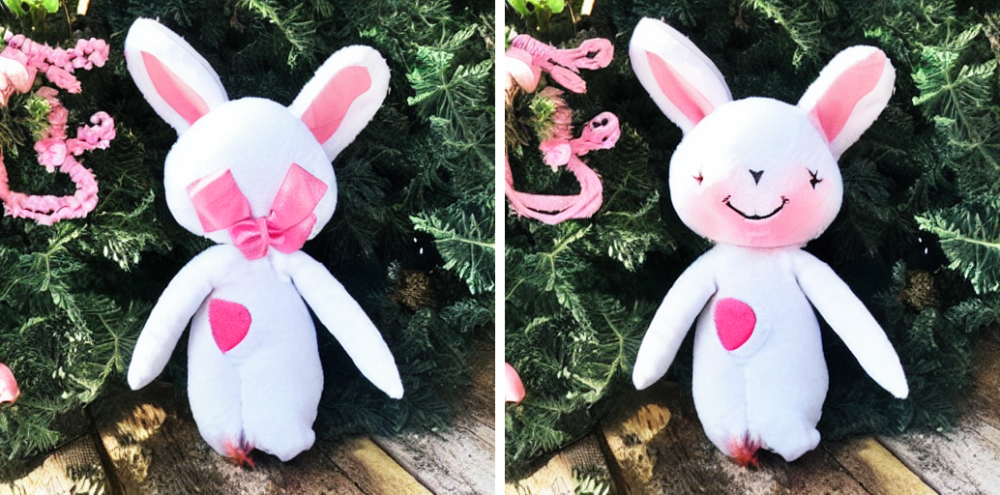

In [ ]:
prompts = ["a smiling bunny doll"] * 2

### pay 3 times more attention to the word "smiling"
equalizer = get_equalizer(prompts[1], ("smiling",), (5,))
controller = AttentionReweight(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                               self_replace_steps=.4,
                               equalizer=equalizer)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

  0%|          | 0/51 [00:00<?, ?it/s]

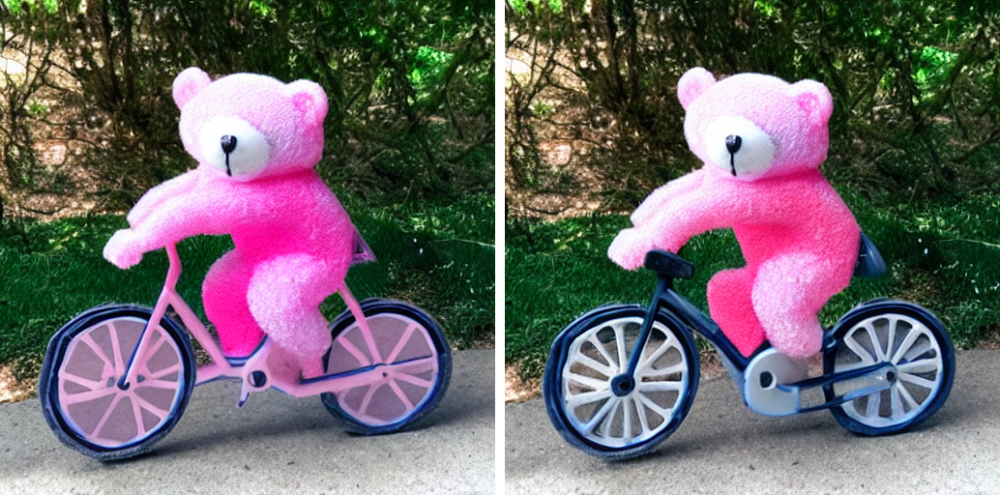

In [ ]:
prompts = ["pink bear riding a bicycle"] * 2

### we don't wont pink bikes, only pink bear.
### we reduce the amount of pink but apply it locally on the bikes (attention re-weight + local mask )

### pay less attention to the word "pink"
equalizer = get_equalizer(prompts[1], ("pink",), (-1,))

### apply the edit on the bikes 
lb = LocalBlend(prompts, ("bicycle", "bicycle"))
controller = AttentionReweight(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                               self_replace_steps=.4,
                               equalizer=equalizer,
                               local_blend=lb)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

### Where are my croutons?
It might be useful to use Attention Re-Weighting with a previous edit method.

  0%|          | 0/51 [00:00<?, ?it/s]

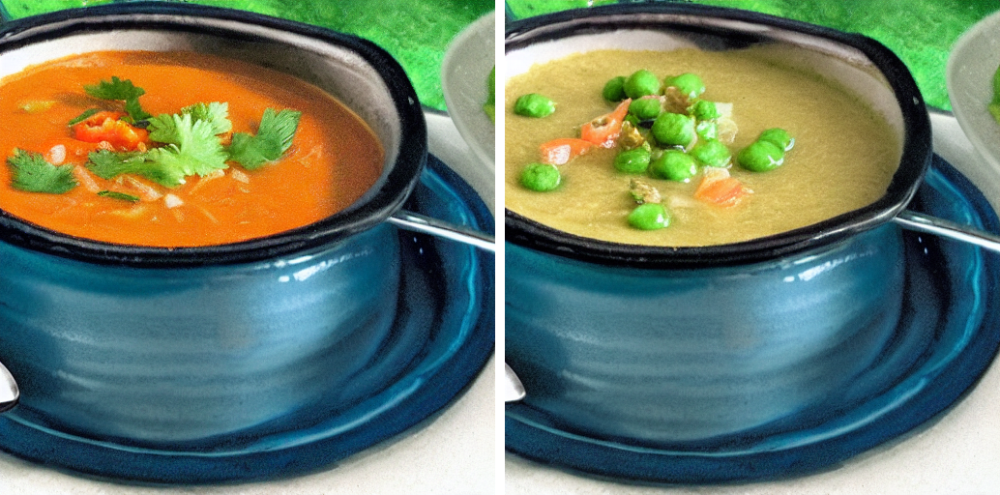

In [ ]:
prompts = ["soup",
           "pea soup with croutons"] 
lb = LocalBlend(prompts, ("soup", "soup"))
controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                             self_replace_steps=.4, local_blend=lb)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

Now, with more attetnion to `"croutons"`

  0%|          | 0/51 [00:00<?, ?it/s]

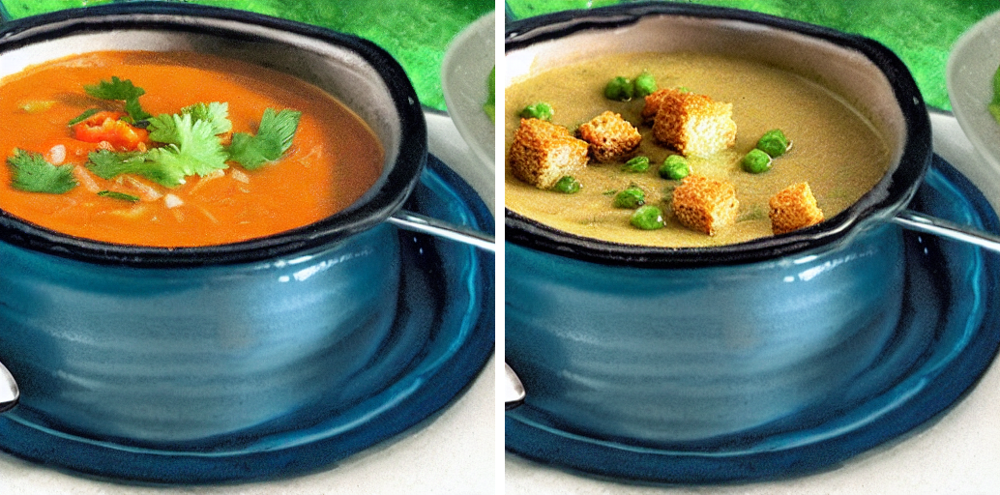

In [ ]:
prompts = ["soup",
           "pea soup with croutons"] 


lb = LocalBlend(prompts, ("soup", "soup"))
controller_a = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8, 
                               self_replace_steps=.4, local_blend=lb)

### pay 3 times more attention to the word "croutons"
equalizer = get_equalizer(prompts[1], ("croutons",), (3,))
controller = AttentionReweight(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                               self_replace_steps=.4, equalizer=equalizer, local_blend=lb,
                               controller=controller_a)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

  0%|          | 0/51 [00:00<?, ?it/s]

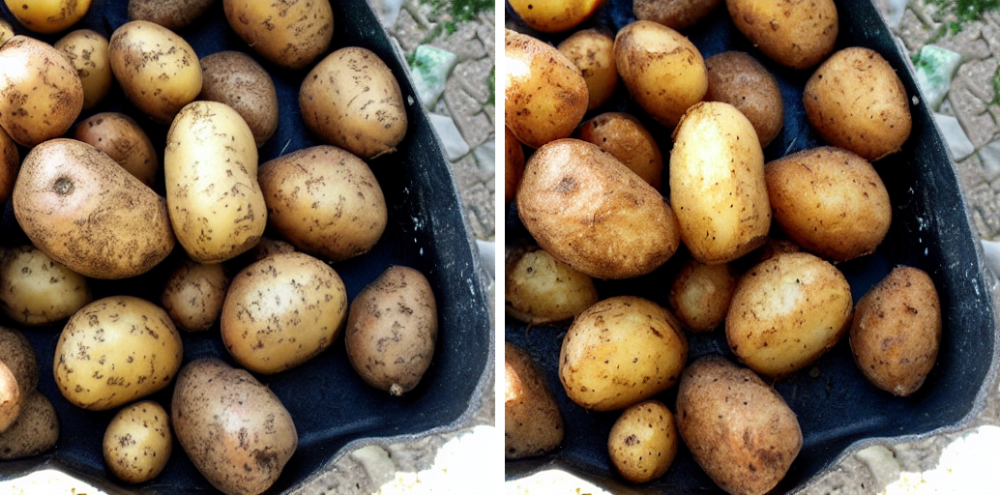

In [ ]:
prompts = ["potatos",
           "fried potatos"] 
lb = LocalBlend(prompts, ("potatos", "potatos"))
controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                             self_replace_steps=.4, local_blend=lb)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)

  0%|          | 0/51 [00:00<?, ?it/s]

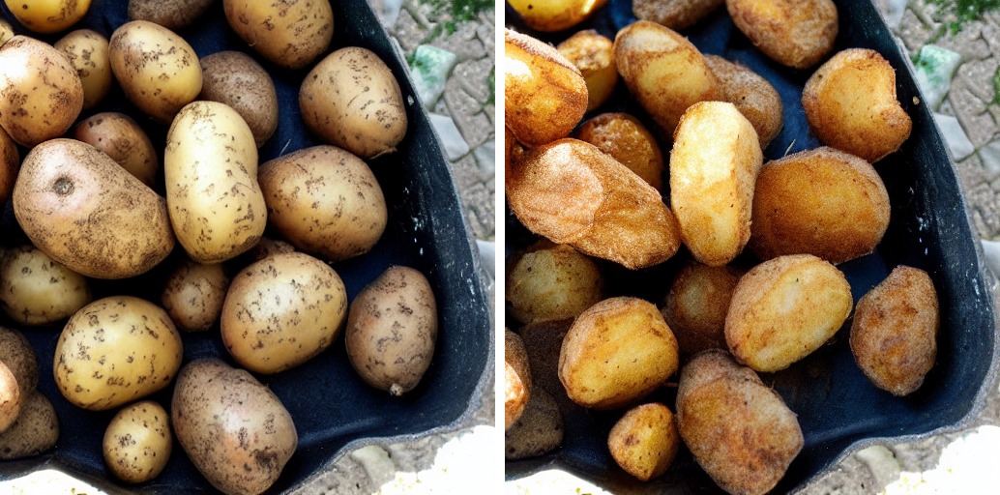

In [ ]:
prompts = ["potatos",
           "fried potatos"] 
lb = LocalBlend(prompts, ("potatos", "potatos"))
controller = AttentionRefine(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8, 
                             self_replace_steps=.4, local_blend=lb)

### pay 10 times more attention to the word "fried"
equalizer = get_equalizer(prompts[1], ("fried",), (10,))
controller = AttentionReweight(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=.8,
                               self_replace_steps=.4, equalizer=equalizer, local_blend=lb,
                               controller=controller_a)
_ = run_and_display(prompts, controller, latent=x_t, run_baseline=False)